<a href="https://colab.research.google.com/github/lionReichl2357/Detectron/blob/main/Detectron2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Imports & Install detectron2

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!python -m pip install pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 3.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for pyyaml: filename=PyYAML-5.1-cp310-cp310-linux_x86_64.whl size=44089 sha256=24cd55a76d86992b3fbf8cbaa0f0f2cc49df1cae18d4efba5e0e5cdb72614bdf
  Stored in directory: /root/.cache/pip/wheels/70/83/31/975b737609aba39a4099d471d5684141c1fdc3404f97e7f68a
Successfully built pyyaml
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 6.0.1
    Uninstalling PyYAML-6.0.1:
      Successfully uninstalled PyYAML-6.0.1
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
dask 2023.8.1 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
distributed 2023.8.1 requires pyyaml>=5.3.1, but you have pyyaml 5.1 which is incompatible.
flax 0.7.2 requires PyYAML>=5.4.1, but you have pyyaml 5.1 which is incompatible.

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  2.0 ; cuda:  cu118
detectron2: 0.6


In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.data import transforms as T
import random
import cv2
import os
import shutil
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.utils.visualizer import Visualizer
from google.colab import files

# Train on my Gerolsteiner dataset

## Prepare the dataset

### upload and split images, annotations


#### 1. Uploading and splitting images:

In [ ]:
from google.colab import files
import os
import shutil  # For moving files
import json

# Path to the directory of the notebook and images in your Drive
drive_base_dir = "/content/drive/MyDrive/Colab Notebooks/HiWi/Palette_Detection"

# Paths to images, test images, and inference images in Drive
drive_images_path = os.path.join(drive_base_dir, 'images_train')
drive_test_images_path = os.path.join(drive_base_dir, 'images_test')
drive_inference_images_path = os.path.join(drive_base_dir, 'images_inference')

# List of uploaded files for training, validation, test, and inference
uploaded_files = os.listdir(drive_images_path)
test_files = os.listdir(drive_test_images_path)
inference_files = os.listdir(drive_inference_images_path)

# Define desired paths in Colab environment
root_path = '/content/dataset_root/'
train_images_path = os.path.join(root_path, 'train/images/')
val_images_path = os.path.join(root_path, 'val/images/')
test_images_path = os.path.join(root_path, 'test/images/')
inference_images_path = os.path.join(root_path, 'inference/images/')

# Ensure the directories exist
os.makedirs(train_images_path, exist_ok=True)
os.makedirs(val_images_path, exist_ok=True)
os.makedirs(test_images_path, exist_ok=True)
os.makedirs(inference_images_path, exist_ok=True)

# Split the training/validation files
split_point = int(0.9 * len(uploaded_files))
train_files = uploaded_files[:split_point]
val_files = uploaded_files[split_point:]

# Copy train and validation images to respective folders in Colab's environment
for fn in train_files:
    shutil.copy(os.path.join(drive_images_path, fn), os.path.join(train_images_path, fn))
for fn in val_files:
    shutil.copy(os.path.join(drive_images_path, fn), os.path.join(val_images_path, fn))

# Copy test images to the test folder in Colab's environment
for fn in test_files:
    shutil.copy(os.path.join(drive_test_images_path, fn), os.path.join(test_images_path, fn))

# Copy inference images to the respective folder in Colab's environment
for fn in inference_files:
    shutil.copy(os.path.join(drive_inference_images_path, fn), os.path.join(inference_images_path, fn))


#### 2. Handling and organizing annotations:


import from drive


In [ ]:
#import from drive

import os
import shutil  # For moving/copying files

# Define the path where your annotations are stored in Google Drive
drive_annotations_path = '/content/drive/MyDrive/Colab Notebooks/HiWi/Palette_Detection/annotations_train'
drive_annotations_test_path = '/content/drive/MyDrive/Colab Notebooks/HiWi/Palette_Detection/annotations_test'
drive_annotations_inference_path = '/content/drive/MyDrive/Colab Notebooks/HiWi/Palette_Detection/annotations_inference'

# List all annotation files in the Google Drive directories
annotation_files = os.listdir(drive_annotations_path)
annotation_files_test = os.listdir(drive_annotations_test_path)
annotation_files_inference = os.listdir(drive_annotations_inference_path)

# Define your desired paths in the Colab environment
path_annotations = '/content/annotations/'
path_annotations_test = '/content/annotations_test/'
path_annotations_inference = '/content/annotations_inference/'

# Ensure the directories exist
os.makedirs(path_annotations, exist_ok=True)
os.makedirs(path_annotations_test, exist_ok=True)
os.makedirs(path_annotations_inference, exist_ok=True)

# Copy the annotation files from Google Drive to the desired paths in Colab's environment
for fn in annotation_files:
    shutil.copy(os.path.join(drive_annotations_path, fn), os.path.join(path_annotations, fn))
for fn in annotation_files_test:
    shutil.copy(os.path.join(drive_annotations_test_path, fn), os.path.join(path_annotations_test, fn))
for fn in annotation_files_inference:
    shutil.copy(os.path.join(drive_annotations_inference_path, fn), os.path.join(path_annotations_inference, fn))


format

train, val annotations

In [ ]:
train_annotations_path = os.path.join(root_path, 'train/annotations/')
val_annotations_path = os.path.join(root_path, 'val/annotations/')

# Ensure the annotations directories exist
os.makedirs(train_annotations_path, exist_ok=True)
os.makedirs(val_annotations_path, exist_ok=True)

# List all JSON files in the annotations directory
json_files = [file for file in os.listdir(path_annotations) if file.endswith('.json')]

# Initialize the new structure for combining data
new_data = {
    "images": [],
    "annotations": [],
    "categories": []
}

# Process and organize each annotation file
for json_file in json_files:
    with open(os.path.join(path_annotations, json_file), 'r') as file:
        data = json.load(file)

        # Extend the combined data with information from the current file
        new_data["images"].extend(data["images"])
        new_data["annotations"].extend(data["annotations"])
        new_data["categories"] = data["categories"]  # Assuming all files have the same categories

# Create a set of image ids for both train and validation datasets
train_image_ids = {image["id"] for image in new_data["images"] if image["file_name"] in train_files}
val_image_ids = {image["id"] for image in new_data["images"] if image["file_name"] in val_files}

# Split the annotations according to the image ids, thus the train/val split done for images
train_annotations = [annotation for annotation in new_data["annotations"] if annotation["image_id"] in train_image_ids]
val_annotations = [annotation for annotation in new_data["annotations"] if annotation["image_id"] in val_image_ids]

# Filter the images based on the image ids for both train and validation datasets
train_images = [image for image in new_data["images"] if image["id"] in train_image_ids]
val_images = [image for image in new_data["images"] if image["id"] in val_image_ids]

# Save split annotations into separate files
with open(os.path.join(train_annotations_path, 'annotations.json'), 'w') as train_file:
    json.dump({"images": train_images, "annotations": train_annotations, "categories": new_data["categories"]}, train_file)

with open(os.path.join(val_annotations_path, 'annotations.json'), 'w') as val_file:
    json.dump({"images": val_images, "annotations": val_annotations, "categories": new_data["categories"]}, val_file)


test annotations

In [ ]:
# Step 1: Define the test annotations directory
test_annotations_path = os.path.join(root_path, 'test/annotations/')

# Step 2: Ensure the test annotations directory exists
os.makedirs(test_annotations_path, exist_ok=True)

# Step 3: List all JSON files in the annotations_test directory
json_files_test = [file for file in os.listdir(path_annotations_test) if file.endswith('.json')]

# Step 4: Initialize the new structure for combining test data
new_data_test = {
    "images": [],
    "annotations": [],
    "categories": []
}

# Step 5: Process and organize each annotation file for test data
for json_file in json_files_test:
    with open(os.path.join(path_annotations_test, json_file), 'r') as file:
        data = json.load(file)

        # Extend the combined test data with information from the current file
        new_data_test["images"].extend(data["images"])
        new_data_test["annotations"].extend(data["annotations"])
        new_data_test["categories"] = data["categories"]  # Assuming all files have the same categories

# Step 6: Filter the test images based on the image ids
test_image_ids = {image["id"] for image in new_data_test["images"]}
test_images = [image for image in new_data_test["images"] if image["id"] in test_image_ids]
test_annotations = [annotation for annotation in new_data_test["annotations"] if annotation["image_id"] in test_image_ids]

# Step 7: Save the processed annotations into the test annotations directory
with open(os.path.join(test_annotations_path, 'annotations.json'), 'w') as test_file:
    json.dump({"images": test_images, "annotations": test_annotations, "categories": new_data_test["categories"]}, test_file)


inference annotations

In [ ]:
# Step 1: Define the inference annotations directory
inference_annotations_path = os.path.join(root_path, 'inference/annotations/')

# Step 2: Ensure the inference annotations directory exists
os.makedirs(inference_annotations_path, exist_ok=True)

# Step 3: List all JSON files in the annotations_inference directory
json_files_inference = [file for file in os.listdir(path_annotations_inference) if file.endswith('.json')]

# Step 4: Initialize the new structure for combining inference data
new_data_inference = {
    "images": [],
    "annotations": [],
    "categories": []
}

# Step 5: Process and organize each annotation file for inference data
for json_file in json_files_inference:
    with open(os.path.join(path_annotations_inference, json_file), 'r') as file:
        data = json.load(file)

        # Extend the combined inference data with information from the current file
        new_data_inference["images"].extend(data["images"])
        new_data_inference["annotations"].extend(data["annotations"])
        new_data_inference["categories"] = data["categories"]  # Assuming all files have the same categories

# Step 6: Filter the inference images based on the image ids
inference_image_ids = {image["id"] for image in new_data_inference["images"]}
inference_images = [image for image in new_data_inference["images"] if image["id"] in inference_image_ids]
inference_annotations = [annotation for annotation in new_data_inference["annotations"] if annotation["image_id"] in inference_image_ids]

# Step 7: Save the processed annotations into the inference annotations directory
with open(os.path.join(inference_annotations_path, 'annotations.json'), 'w') as inference_file:
    json.dump({"images": inference_images, "annotations": inference_annotations, "categories": new_data_inference["categories"]}, inference_file)


In [ ]:
#make sure there is at least one category (necessary for the Detectron2 COCO data loader)
inference_annotations_path = os.path.join(root_path, 'inference/annotations/annotations.json')
with open(inference_annotations_path, "r") as f:
    data = json.load(f)

if "categories" not in data or len(data["categories"]) == 0:
    dummy_category = {
        "id": 1,
        "name": "Palette_Loaded",
        "supercategory": ""
    }
    data["categories"] = [dummy_category]
with open(inference_annotations_path, "w") as f:
    json.dump(data, f)


### register dataset

register datasets

In [ ]:
from detectron2.data.datasets import register_coco_instances

# Registering the training dataset
train_annotations_path = os.path.join(root_path, 'train/annotations/annotations.json')
train_images_path = os.path.join(root_path, 'train/images/')
register_coco_instances("gerolsteiner_dataset_train", {}, train_annotations_path, train_images_path)

# Registering the validation dataset
val_annotations_path = os.path.join(root_path, 'val/annotations/annotations.json')
val_images_path = os.path.join(root_path, 'val/images/')
register_coco_instances("gerolsteiner_dataset_val", {}, val_annotations_path, val_images_path)

# Registering the test dataset
test_annotations_path = os.path.join(root_path, 'test/annotations/annotations.json')
test_images_path = os.path.join(root_path, 'test/images/')
register_coco_instances("gerolsteiner_dataset_test", {}, test_annotations_path, test_images_path)

# Registering the inference dataset
inference_annotations_path = os.path.join(root_path, 'inference/annotations/annotations.json')
inference_images_path = os.path.join(root_path, 'inference/images/')
register_coco_instances("gerolsteiner_dataset_inference", {}, inference_annotations_path, inference_images_path)

To verify the dataset is in correct format, let's visualize the annotations of randomly selected samples in the training set:



WARNING [09/02 11:23:17 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[09/02 11:23:17 d2.data.datasets.coco]: Loaded 162 images in COCO format from /content/dataset_root/train/annotations/annotations.json


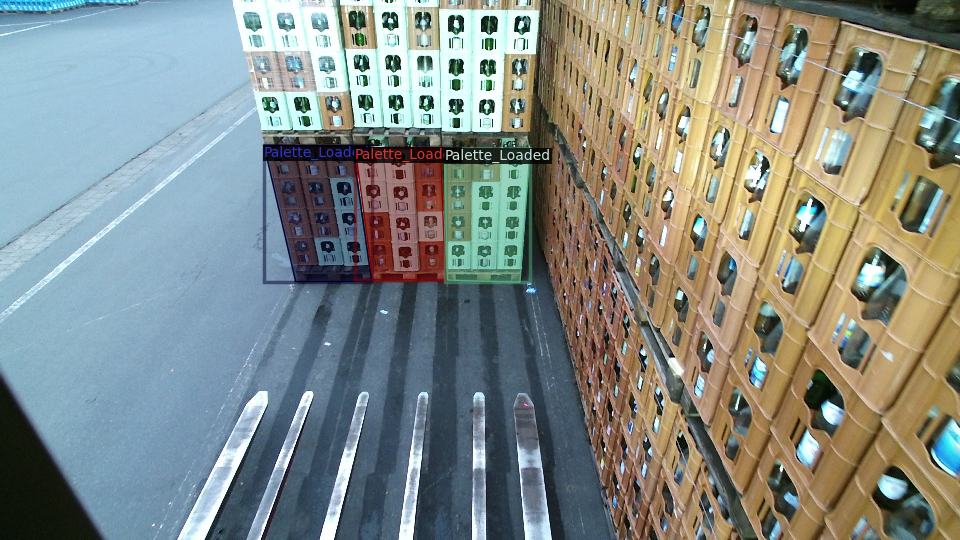

In [ ]:
import random
import cv2
from detectron2.data import DatasetCatalog, MetadataCatalog
from detectron2.utils.visualizer import Visualizer
from google.colab.patches import cv2_imshow

# Get your dataset
dataset_name = "gerolsteiner_dataset_train"  # Or "gerolsteiner_dataset_val" for the validation set
dataset_dicts = DatasetCatalog.get(dataset_name)
dataset_metadata = MetadataCatalog.get(dataset_name)

# Calculate how many samples to visualize (all images but capped at 10)
num_samples = min(len(dataset_dicts), 1)


# Visualize the samples
for d in random.sample(dataset_dicts, num_samples):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=dataset_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])


## Train

Now, let's fine-tune a COCO-pretrained R50-FPN Mask R-CNN model on the dataset.


In [ ]:
load_from_drive = True
to_train = False

regular evaluation

In [ ]:
from detectron2.data import build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.engine import DefaultTrainer

def do_evaluation(cfg, model, iteration=None):
    evaluator = COCOEvaluator("gerolsteiner_dataset_val", cfg, False, output_dir=cfg.OUTPUT_DIR)
    val_loader = build_detection_test_loader(cfg, "gerolsteiner_dataset_val")
    inference_on_dataset(model, val_loader, evaluator)
class CustomTrainer(DefaultTrainer):
    @classmethod
    def build_evaluator(cls, cfg, dataset_name, output_folder=None):
        if output_folder is None:
            output_folder = os.path.join(cfg.OUTPUT_DIR, "inference")
        return COCOEvaluator(dataset_name, cfg, False, output_folder)

    def train(self):
        evaluator = COCOEvaluator("gerolsteiner_dataset_val", output_dir="./output")
        val_loader = build_detection_test_loader(cfg, "gerolsteiner_dataset_val")
        predictor = DefaultPredictor(self.cfg)
        print(inference_on_dataset(predictor.model, val_loader, evaluator))
        super().train()



model setup

In [ ]:
cfg = get_cfg()

# Add the boolean variable
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))

# Define the path to your saved model weights on Google Drive
model_path_on_drive = "/content/drive/MyDrive/Colab Notebooks/HiWi/Palette_Detection/model_storage/model_weights.pth"

if load_from_drive:
    # Make sure you've mounted the drive before this
    cfg.MODEL.WEIGHTS = model_path_on_drive
else:
    cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")

cfg.DATASETS.TRAIN = ("gerolsteiner_dataset_train",)
cfg.DATASETS.TEST = ("gerolsteiner_dataset_val",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.00025
cfg.SOLVER.MAX_ITER = 300
cfg.SOLVER.STEPS = []
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 128
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1

# Define the augmentation techniques and their parameters
augmentation = [
    T.ResizeShortestEdge(short_edge_length=(640, 672, 704, 736, 768, 800), max_size=1333, sample_style="choice"),
    T.RandomFlip(horizontal=True, vertical=False),
    T.RandomBrightness(0.8, 1.8),
    T.RandomContrast(0.6, 1.3),
    T.RandomSaturation(0.8, 1.4),
    T.RandomRotation(angle=[90, 90]),
    T.RandomCrop("relative_range", (0.8, 0.8)),
]

# Add the augmentation to your configuration
cfg.DATASETS.AUGMENTATION = augmentation


training

In [ ]:

if to_train:
    os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
    trainer = CustomTrainer(cfg)
    trainer.resume_or_load(resume=False)
    trainer.train()


###save

save into drive

In [ ]:
save_path = "/content/drive/MyDrive/Colab Notebooks/HiWi/Palette_Detection/model_storage/model_weights.pth"
if to_train:
    torch.save(trainer.model.state_dict(), save_path)

###tensorboard

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

## Noisy student apporach

knowledge destillation

generate pseudo labels

In [ ]:
from detectron2.structures import BoxMode

def generate_pseudo_labels(teacher, unlabeled_dataset, threshold=0.7):
    pseudo_labelled_data = []

    for idx, data in enumerate(unlabeled_dataset):
        # Load the image
        img = cv2.imread(data["file_name"])

        # Make a prediction using the teacher model
        outputs = teacher(img)

        # Print the scores for debugging
        print(f"Image {idx} prediction scores:", outputs["instances"].scores.tolist())

        # Filter instances above the threshold
        instances = outputs["instances"]
        keep = instances.scores > threshold
        instances = instances[keep]

        if len(instances) == 0:
            continue

        # Convert predictions to dataset dict format
        record = {}
        record["file_name"] = data["file_name"]
        record["height"] = img.shape[0]
        record["width"] = img.shape[1]
        record["annotations"] = []

        for i in range(len(instances)):
            ann = {}
            ann["bbox"] = instances.pred_boxes.tensor[i].tolist()
            ann["bbox_mode"] = BoxMode.XYXY_ABS
            ann["category_id"] = instances.pred_classes[i].item()
            #ann["segmentation"] = instances.pred_masks[i].numpy().astype("uint8")  # if you use mask prediction
            record["annotations"].append(ann)

        pseudo_labelled_data.append(record)

    return pseudo_labelled_data


from detectron2.modeling import build_model
from detectron2.checkpoint import DetectionCheckpointer
from detectron2.data import DatasetCatalog
from detectron2.config import get_cfg
from detectron2.engine import DefaultPredictor

# Step 1: Set up the teacher model from the config.
#cfg has to be set up as in training loop. WEIGHTS can be modified
#cfg = get_cfg()
#cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
#cfg.MODEL.WEIGHTS = save_path = "/content/drive/MyDrive/Colab Notebooks/HiWi/Palette_Detection/model_storage/model_weights.pth"  # <-- Replace with the path where your trained weights are saved.

# Step 3: Create the DefaultPredictor for the teacher.
teacher = DefaultPredictor(cfg)

# Step 4: Load your unlabeled dataset and generate pseudo-labels.
unlabeled_dataset_dicts = DatasetCatalog.get("gerolsteiner_dataset_inference")
pseudo_labels = generate_pseudo_labels(teacher, unlabeled_dataset_dicts, threshold=0.7)


[09/02 11:34:31 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/Colab Notebooks/HiWi/Palette_Detection/model_storage/model_weights.pth ...
[09/02 11:34:32 d2.data.datasets.coco]: Loaded 29 images in COCO format from /content/dataset_root/inference/annotations/annotations.json
Image 0 prediction scores: []
Image 1 prediction scores: [0.9756110310554504, 0.9633034467697144, 0.9570242762565613, 0.9546608924865723, 0.94350665807724]
Image 2 prediction scores: [0.987970769405365, 0.9800556302070618, 0.9785856008529663, 0.9426199793815613]
Image 3 prediction scores: [0.9752597212791443, 0.9647188782691956, 0.7698182463645935]
Image 4 prediction scores: [0.9795178771018982, 0.9783579111099243, 0.9775938987731934, 0.9732435345649719, 0.9683922529220581, 0.8886695504188538, 0.8775171041488647, 0.7427038550376892]
Image 5 prediction scores: [0.986861526966095, 0.9809044003486633, 0.9779959917068481, 0.9718866348266602, 0.965230405330658, 0.9370739

In [ ]:
print(size(pseudo_labels))

[{'file_name': '/content/dataset_root/inference/images/1571949262.272268534.jpg', 'height': 1080, 'width': 1920, 'annotations': [{'bbox': [266.39556884765625, 263.3083801269531, 367.8048095703125, 396.66314697265625], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'category_id': 0}, {'bbox': [145.2557373046875, 265.453369140625, 264.0309753417969, 407.4285888671875], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'category_id': 0}, {'bbox': [426.4724426269531, 261.39892578125, 566.347412109375, 401.2096252441406], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'category_id': 0}, {'bbox': [357.4869689941406, 256.38372802734375, 449.4863586425781, 399.9425354003906], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'category_id': 0}, {'bbox': [536.4029541015625, 228.65061950683594, 640.0, 397.64642333984375], 'bbox_mode': <BoxMode.XYXY_ABS: 0>, 'category_id': 0}]}, {'file_name': '/content/dataset_root/inference/images/1571964385.672530413.jpg', 'height': 1080, 'width': 1920, 'annotations': [{'bbox': [279.5432434082031, 133.532226562

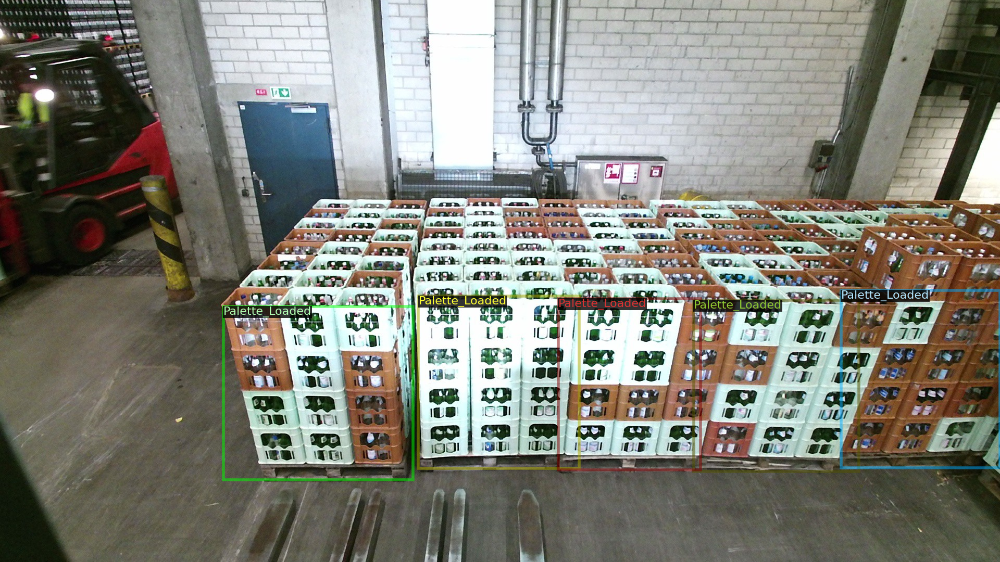

In [ ]:
from detectron2.utils.visualizer import Visualizer, ColorMode
from detectron2.data import MetadataCatalog
from google.colab.patches import cv2_imshow

from google.colab.patches import cv2_imshow

def visualize_pseudo_labels(dataset_dicts, pseudo_labels, metadata):
    for data in dataset_dicts:
        img_path = data["file_name"]
        corresponding_label = next((label for label in pseudo_labels if label["file_name"] == img_path), None)

        if corresponding_label:
            img = cv2.imread(img_path)
            visualizer = Visualizer(img[:, :, ::-1], metadata=metadata)
            vis_output = visualizer.draw_dataset_dict(corresponding_label)
            cv2_imshow(vis_output.get_image()[:, :, ::-1])


# Use the function to visualize the pseudo labeled images
metadata = MetadataCatalog.get("gerolsteiner_dataset_inference")
visualize_pseudo_labels(unlabeled_dataset_dicts, pseudo_labels, metadata)


## Inference & evaluation using the trained model
Now, let's run inference with the trained model on the balloon validation dataset. First, let's create a predictor using the model we just trained:



In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
#cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.WEIGHTS = save_path = "/content/drive/MyDrive/Colab Notebooks/HiWi/Palette_Detection/model_storage/model_weights.pth"  # <-- Replace with the path where your trained weights are saved.

cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.70   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[09/02 11:28:11 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/MyDrive/Colab Notebooks/HiWi/Palette_Detection/model_storage/model_weights.pth ...


Then, we randomly select several samples to visualize the prediction results.

In [ ]:
# Get your dataset
dataset_name = "gerolsteiner_dataset_val"
dataset_dicts = DatasetCatalog.get(dataset_name)
dataset_metadata = MetadataCatalog.get(dataset_name)
print(dataset_dicts[0]) #a dataset_dicts is a list of dictionaries. Each dictrionary describing one image

WARNING [09/02 11:28:16 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[09/02 11:28:16 d2.data.datasets.coco]: Loaded 19 images in COCO format from /content/dataset_root/val/annotations/annotations.json
{'file_name': '/content/dataset_root/val/images/1571936424.642760277.jpg', 'height': 1080, 'width': 1920, 'image_id': 174851, 'annotations': [{'iscrowd': False, 'bbox': [589, 57, 279, 535], 'keypoints': [], 'category_id': 0, 'segmentation': [[657.6, 587.9, 589.1, 57.3, 850.5, 63.1, 867.9, 591.8, 659.5, 589.9]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': False, 'bbox': [855, 124, 248, 465], 'keypoints': [], 'category_id': 0, 'segmentation': [[871.7, 587, 855.3, 123.9, 1103.3, 126.8, 1070.5, 588.9, 870.8, 587]], 'bbox_mode': <BoxMode.XYWH_ABS: 1>}, {'iscrowd': False, 'bbox': [1073, 124, 252, 466], 'keypoints': [], 'category_id': 0, 'segmentation': [[1073.4, 585, 1107.1, 125.8, 1325.2, 123.9, 1251.8, 589.9, 1073.4, 58

[09/02 11:31:34 d2.data.datasets.coco]: Loaded 29 images in COCO format from /content/dataset_root/inference/annotations/annotations.json


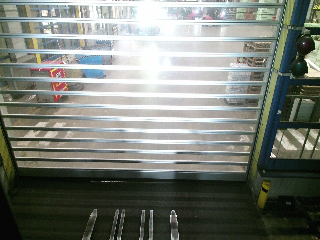

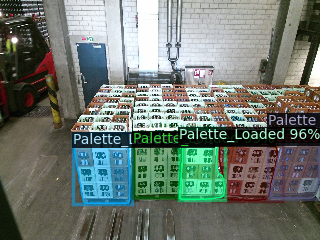

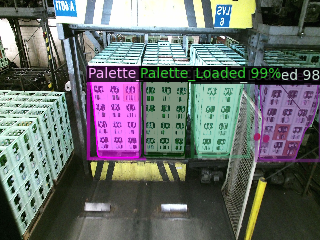

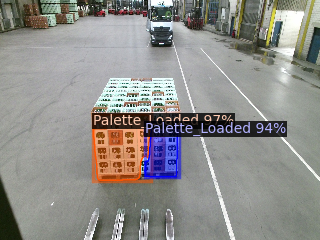

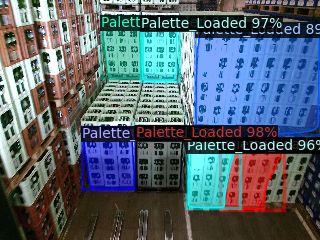

...

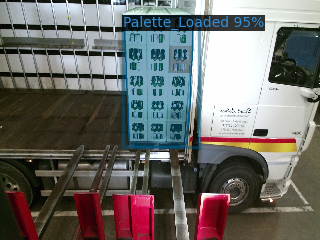

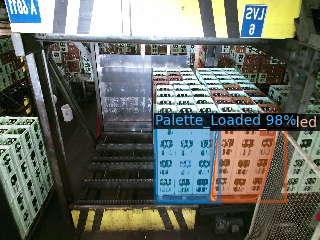

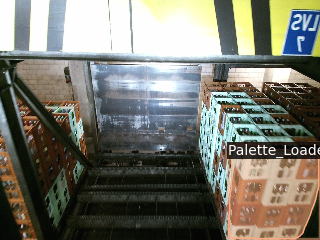

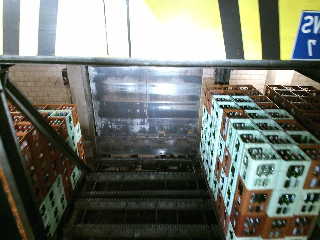

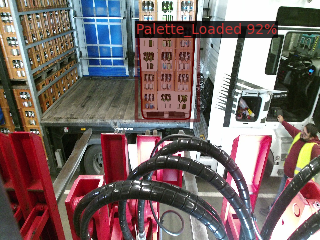

'/content/visualized_images_thresh_0.7.zip'

In [ ]:
# Get your dataset
dataset_name = "gerolsteiner_dataset_inference"
dataset_dicts = DatasetCatalog.get(dataset_name)
dataset_metadata = MetadataCatalog.get(dataset_name)

# Calculate how many samples to visualize (all images but capped at 100)
num_samples = min(len(dataset_dicts), 100)

# Create a directory to save the visualized images
save_dir = "/content/visualized_images"
# If directory exists, remove it along with its contents
if os.path.exists(save_dir):
    shutil.rmtree(save_dir)
os.makedirs(save_dir, exist_ok=True)

# Visualize some samples and save the images
for idx, d in enumerate(dataset_dicts): #enumerate(random.sample(dataset_dicts, num_samples)):
    img = cv2.imread(d["file_name"])
    img_resized = cv2.resize(img, (640, 480))
    outputs = predictor(img_resized)
    visualizer = Visualizer(img_resized[:, :, ::-1], metadata=dataset_metadata, scale=0.5)
    out = visualizer.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

    save_path = os.path.join(save_dir, f"image_{idx}_thresh_{cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST}.jpg")
    cv2.imwrite(save_path, out.get_image()[:, :, ::-1])

# Using Python's shutil to create a zip archive (gets overwritten if already exists)
shutil.make_archive(f"/content/visualized_images_thresh_{cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST}", 'zip', save_dir)

# Download the zip
#files.download(f'/content/visualized_images_thresh_{cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST}.zip')


We can also evaluate its performance using AP metric implemented in COCO API.
This gives an AP of ~70. Not bad!

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader


evaluator = COCOEvaluator("gerolsteiner_dataset_val", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "gerolsteiner_dataset_val")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

# Another equivalent way to evaluate the model is to use `trainer.test`

[09/02 11:27:30 d2.evaluation.coco_evaluation]: Fast COCO eval is not built. Falling back to official COCO eval.
WARNING [09/02 11:27:30 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[09/02 11:27:30 d2.data.datasets.coco]: Loaded 19 images in COCO format from /content/dataset_root/val/annotations/annotations.json
[09/02 11:27:30 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[09/02 11:27:30 d2.data.common]: Serializing the dataset using: <class 'detectron2.data.common._TorchSerializedList'>
[09/02 11:27:30 d2.data.common]: Serializing 19 elements to byte tensors and concatenating them all ...
[09/02 11:27:30 d2.data.common]: Serialized dataset takes 0.01 MiB
[09/02 11:27:30 d2.evaluation.evaluator]: Start inference on 19 batches


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:560: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


[09/02 11:27:32 d2.evaluation.evaluator]: Inference done 11/19. Dataloading: 0.0053 s/iter. Inference: 0.1318 s/iter. Eval: 0.0001 s/iter. Total: 0.1373 s/iter. ETA=0:00:01
[09/02 11:27:33 d2.evaluation.evaluator]: Total inference time: 0:00:01.933988 (0.138142 s / iter per device, on 1 devices)
[09/02 11:27:33 d2.evaluation.evaluator]: Total inference pure compute time: 0:00:01 (0.125003 s / iter per device, on 1 devices)
[09/02 11:27:33 d2.evaluation.coco_evaluation]: Preparing results for COCO format ...
[09/02 11:27:33 d2.evaluation.coco_evaluation]: Saving results to ./output/coco_instances_results.json
[09/02 11:27:33 d2.evaluation.coco_evaluation]: Evaluating predictions with official COCO API...
WARNING [09/02 11:27:33 d2.evaluation.coco_evaluation]: No predictions from the model!
OrderedDict([('bbox', {'AP': nan, 'AP50': nan, 'AP75': nan, 'APs': nan, 'APm': nan, 'APl': nan})])
